<span style="color: blue; font-size: 40px;">

First assignment of the Fault-Tolerant Systems course: 

</span>

```
Simulate the performance of SEU (Single Event Upset) in two identical images in BMP and JPG formats. Conduct enough simulations and analyze the results. Explain the reason for each outcome.
```
```
Change only one bit of a JPEG and a Bitmap image and demonstrate how redundancy enables fault tolerance.
```

### Download a JPEG image from a URL and save it as 'picture.jpg'


In [1]:
! wget -O picture.jpg https://images.alphacoders.com/134/thumb-1920-1343294.jpeg

--2024-10-09 12:35:08--  https://images.alphacoders.com/134/thumb-1920-1343294.jpeg
Resolving images.alphacoders.com (images.alphacoders.com)... 172.67.48.187, 104.20.75.132, 104.20.76.132
Connecting to images.alphacoders.com (images.alphacoders.com)|172.67.48.187|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 213275 (208K) [image/jpeg]
Saving to: ‘picture.jpg’

picture.jpg         100%[===================>] 208.28K   259KB/s    in 0.8s    

2024-10-09 12:35:13 (259 KB/s) - ‘picture.jpg’ saved [213275/213275]



### Convert the downloaded JPEG image to BMP format using ImageMagick's 'convert' command


In [2]:
! convert picture.jpg picture.bmp

### Print the sizes of both the JPEG and BMP images to compare their file sizes.


In [3]:
print("The size of the images:")
! ls -lrh picture.* | awk '{print $5, $9}'

The size of the images:
209K picture.jpg
6.0M picture.bmp


### Install and import the needed libraries

In [4]:
! pip install -r requirements.txt > /dev/null
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import numpy as np
import random

### Load and show the images

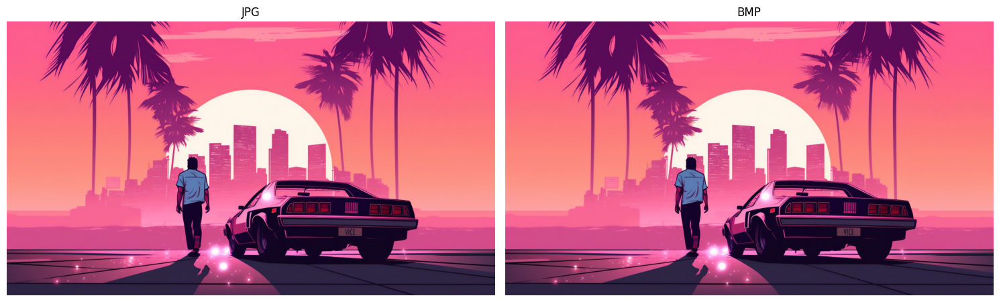

In [5]:
jpg_img_path = 'picture.jpg'
bmp_img_path = 'picture.bmp'

img_jpg = mpimg.imread(jpg_img_path)
img_bmp = mpimg.imread(bmp_img_path)

fig, axs = plt.subplots(1, 2, figsize=(15, 5))

axs[0].imshow(img_jpg)
axs[0].axis('off')
axs[0].set_title('JPG')

axs[1].imshow(img_bmp)
axs[1].axis('off')
axs[1].set_title('BMP')

plt.tight_layout()
plt.show()

### Define a function to flip one bit in the middle of the file

In [6]:
def flip_middle_bit(file_path, output_path):
    with open(file_path, 'rb') as file:
        data = bytearray(file.read())
        
    mid_index = len(data) // 2
    
    # Flip the least significant bit of the middle bit
    data[mid_index] ^= 0x01
    
    with open(output_path, 'wb') as output_file:
        output_file.write(data)

In [7]:
flip_middle_bit('picture.jpg', 'modified_picture.jpg')
flip_middle_bit('picture.bmp', 'modified_picture.bmp')

### Show modified images

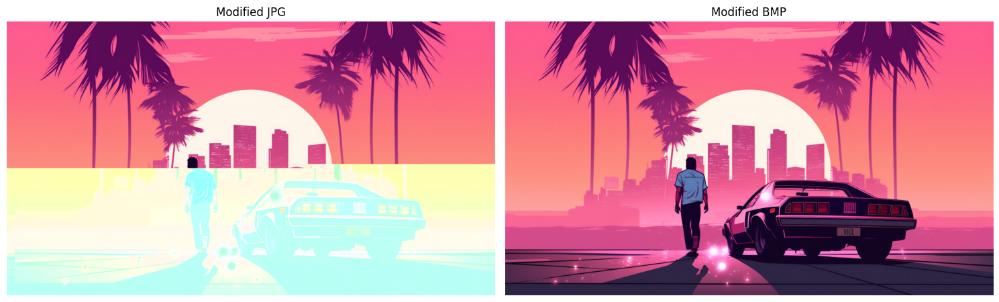

In [8]:
modified_jpg_img_path = 'modified_picture.jpg'
modified_bmp_img_path = 'modified_picture.bmp'

img_jpg = mpimg.imread(modified_jpg_img_path)
img_bmp = mpimg.imread(modified_bmp_img_path)

fig, axs = plt.subplots(1, 2, figsize=(15, 5))

axs[0].imshow(img_jpg)
axs[0].axis('off')
axs[0].set_title('Modified JPG')

axs[1].imshow(img_bmp)
axs[1].axis('off')
axs[1].set_title('Modified BMP')

plt.tight_layout()
plt.show()

### Define a function to compare two images byte by byte

In [9]:
def compare_bits(file1_path, file2_path):
    with open(file1_path, 'rb') as file1, open(file2_path, 'rb') as file2:
        data1 = file1.read()
        data2 = file2.read()
        
    differences = []
    
    for i in range(min(len(data1), len(data2))):
        for bit in range(8):
            if (data1[i] >> bit) & 1 != (data2[i] >> bit) & 1:
                differences.append((i, bit))
    
    return differences

In [10]:
jpg_differences = compare_bits(jpg_img_path, modified_jpg_img_path)
bmp_differences = compare_bits(bmp_img_path, modified_bmp_img_path)

print(f"Number of different bits in JPG: {len(jpg_differences)}")
print("Differences in JPG (byte index, bit index):", jpg_differences)

print(f"\nNumber of different bits in BMP: {len(bmp_differences)}")
print("Differences in BMP (byte index, bit index):", bmp_differences)

Number of different bits in JPG: 1
Differences in JPG (byte index, bit index): [(106637, 0)]

Number of different bits in BMP: 1
Differences in BMP (byte index, bit index): [(3098949, 0)]


## Let's do this a few times...

Setting a random seed so that every time the execution occurs, the random numbers generated for the simulation remain the same, ensuring the simulation results do not change.

In [11]:
np.random.seed(0)
random_percentages = np.random.randint(0, 101, 30)
# print(random_percentages)

In [12]:
def flip_random_bit(file_path, output_path, percentage):
    with open(file_path, 'rb') as file:
        data = bytearray(file.read())
    
    file_size = len(data)
    # bit_to_flip = int((file_size * 8) * (percentage / 100))           # This line of code caused the error!
    total_bits = file_size * 8
    bit_to_flip = min(int(total_bits * (percentage / 100)), total_bits - 1)
    byte_index = bit_to_flip // 8
    bit_index = bit_to_flip % 8
    
    data[byte_index] ^= (1 << bit_index)
    
    with open(output_path, 'wb') as output_file:
        output_file.write(data)
    
    return byte_index, bit_index

In [13]:
def compare_files(file1_path, file2_path):
    with open(file1_path, 'rb') as file1, open(file2_path, 'rb') as file2:
        data1 = file1.read()
        data2 = file2.read()
    
    differences = []
    for i in range(min(len(data1), len(data2))):
        if data1[i] != data2[i]:
            for bit in range(8):
                if (data1[i] >> bit) & 1 != (data2[i] >> bit) & 1:
                    differences.append((i, bit))
    
    return differences

In [14]:
original_jpg = 'picture.jpg'
original_bmp = 'picture.bmp'


Iteration 1:
Random percentage: 44%
JPG: Flipped bit 0 in byte 93841
BMP: Flipped bit 0 in byte 2727075
JPG differences: [(93841, 0)]
BMP differences: [(2727075, 0)]


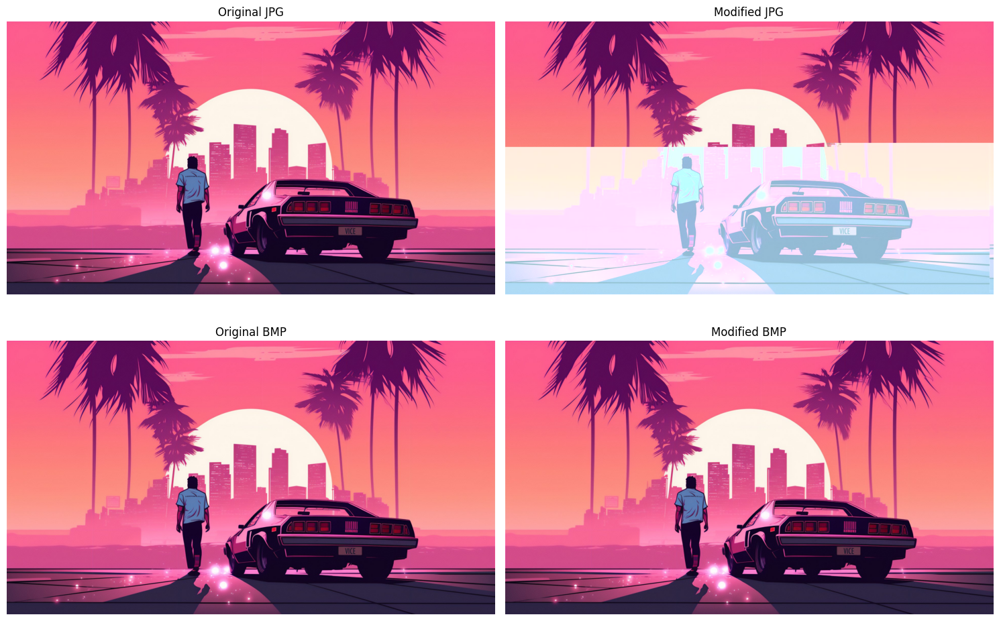


Iteration 2:
Random percentage: 47%
JPG: Flipped bit 2 in byte 100239
BMP: Flipped bit 0 in byte 2913012
JPG differences: [(100239, 2)]
BMP differences: [(2913012, 0)]


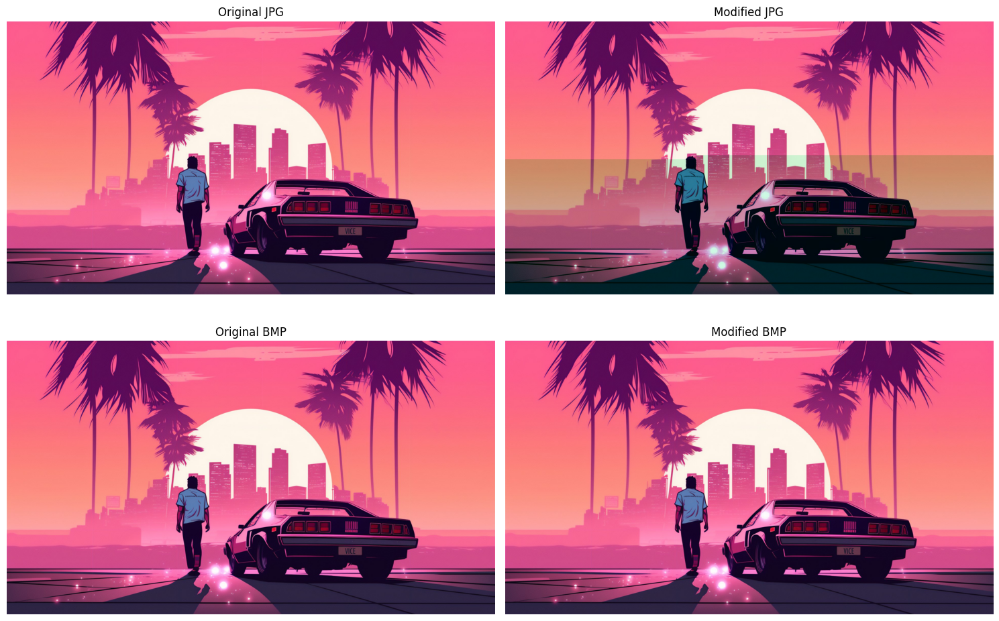


Iteration 3:
Random percentage: 64%
JPG: Flipped bit 0 in byte 136496
BMP: Flipped bit 5 in byte 3966654
JPG differences: [(136496, 0)]
BMP differences: [(3966654, 5)]


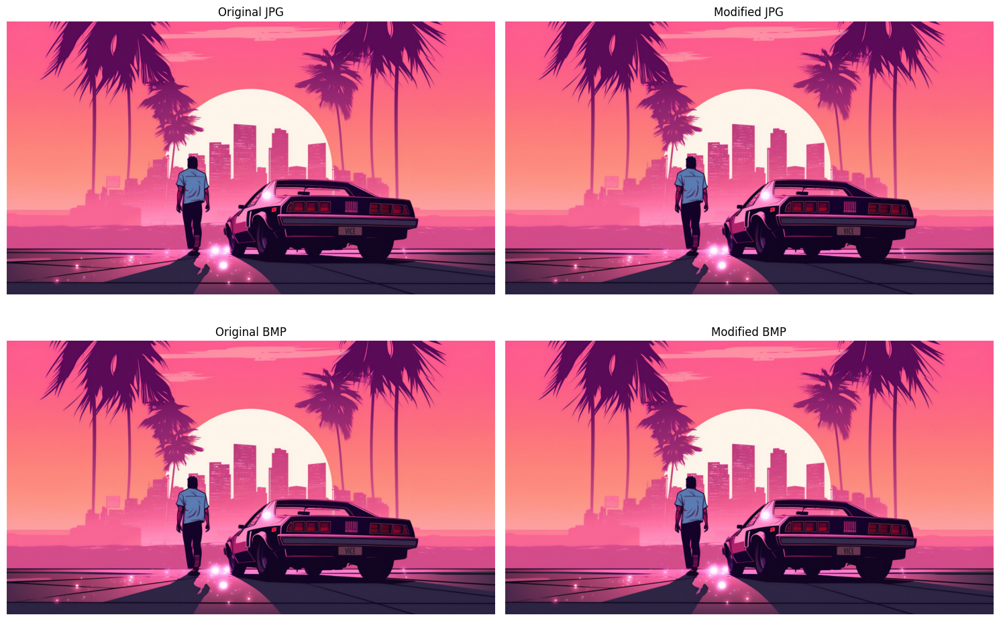


Iteration 4:
Random percentage: 67%
JPG: Flipped bit 2 in byte 142894
BMP: Flipped bit 5 in byte 4152591
JPG differences: [(142894, 2)]
BMP differences: [(4152591, 5)]


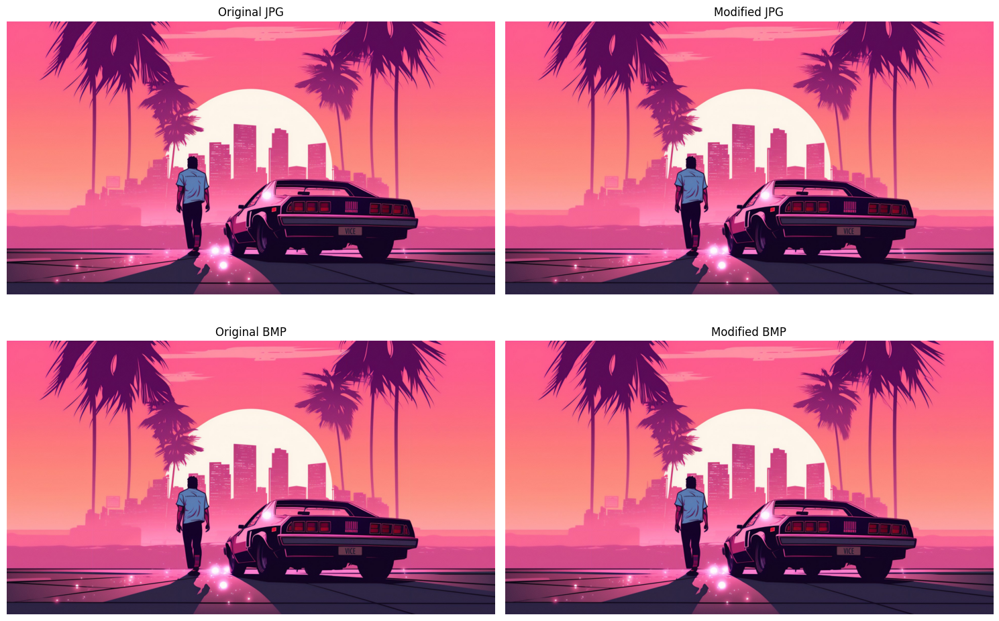


Iteration 5:
Random percentage: 67%
JPG: Flipped bit 2 in byte 142894
BMP: Flipped bit 5 in byte 4152591
JPG differences: [(142894, 2)]
BMP differences: [(4152591, 5)]


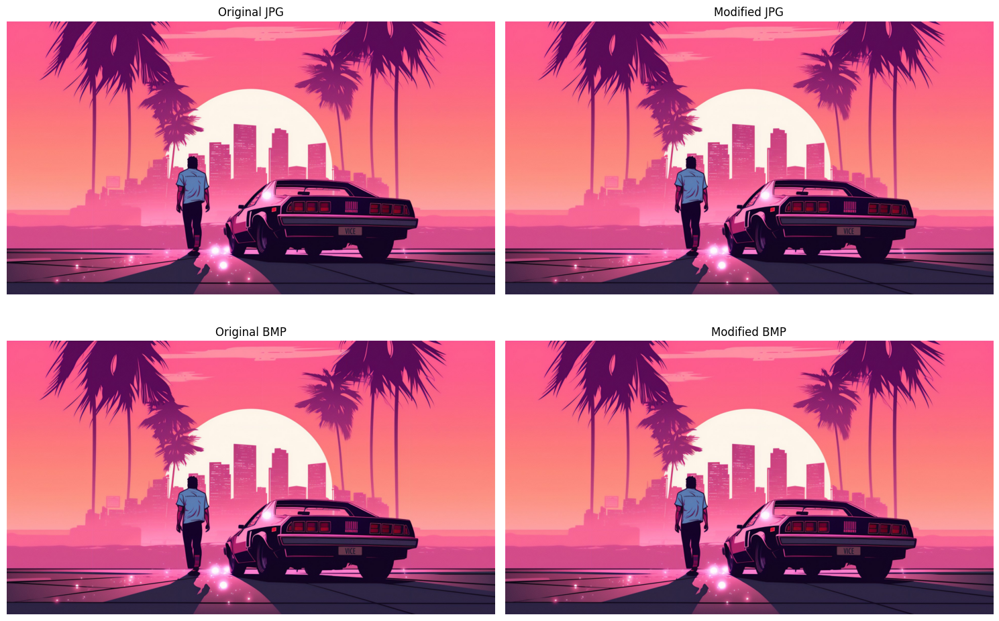


Iteration 6:
Random percentage: 9%
JPG: Flipped bit 6 in byte 19194
BMP: Flipped bit 6 in byte 557810
JPG differences: [(19194, 6)]
BMP differences: [(557810, 6)]


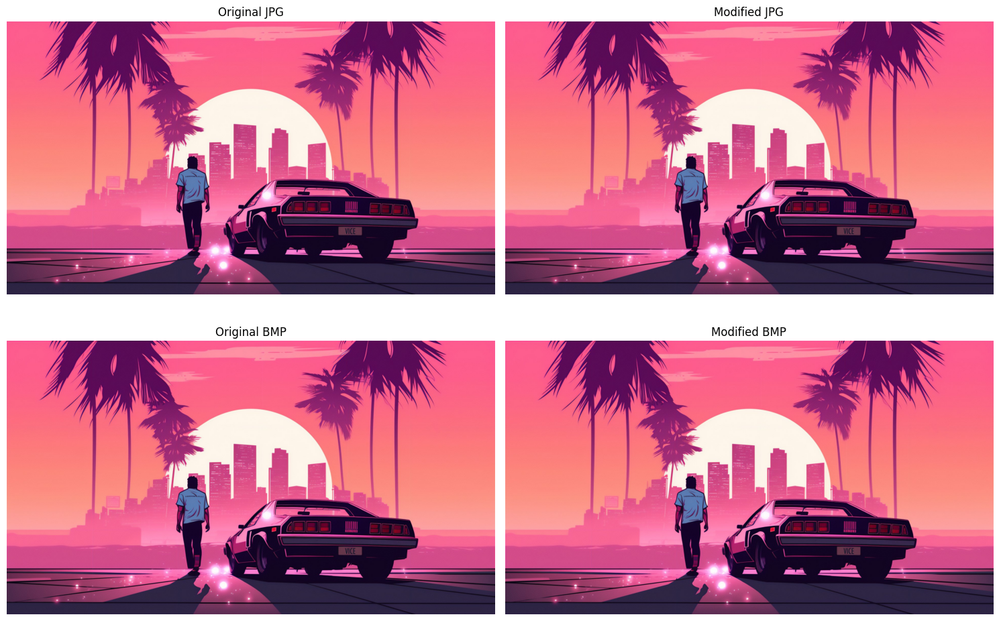


Iteration 7:
Random percentage: 83%
JPG: Flipped bit 2 in byte 177018
BMP: Flipped bit 2 in byte 5144255
JPG differences: [(177018, 2)]
BMP differences: [(5144255, 2)]
Error displaying Modified JPG: broken data stream when reading image file


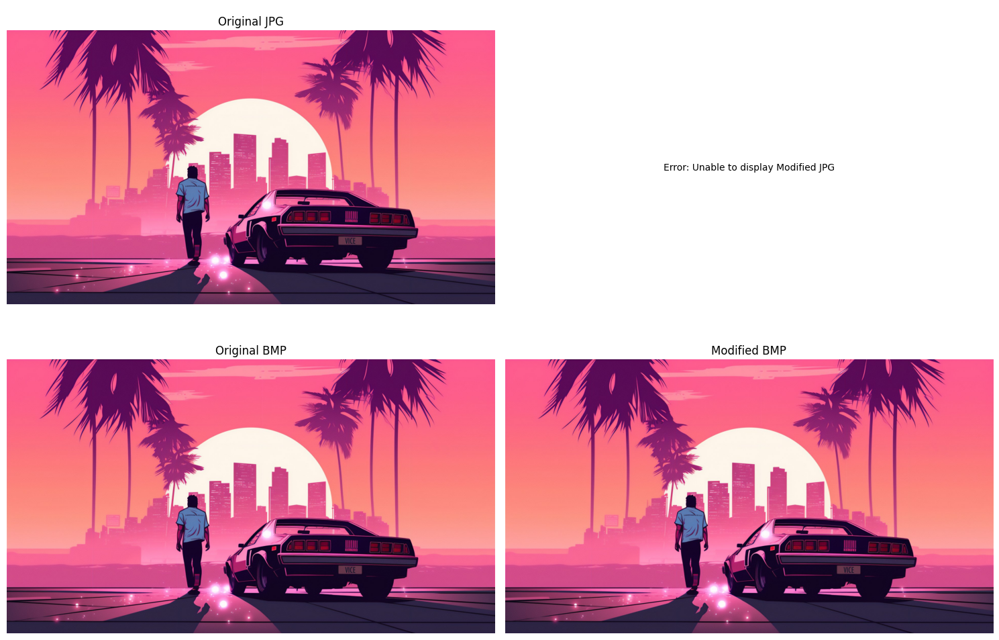


Iteration 8:
Random percentage: 21%
JPG: Flipped bit 6 in byte 44787
BMP: Flipped bit 4 in byte 1301558
JPG differences: [(44787, 6)]
BMP differences: [(1301558, 4)]


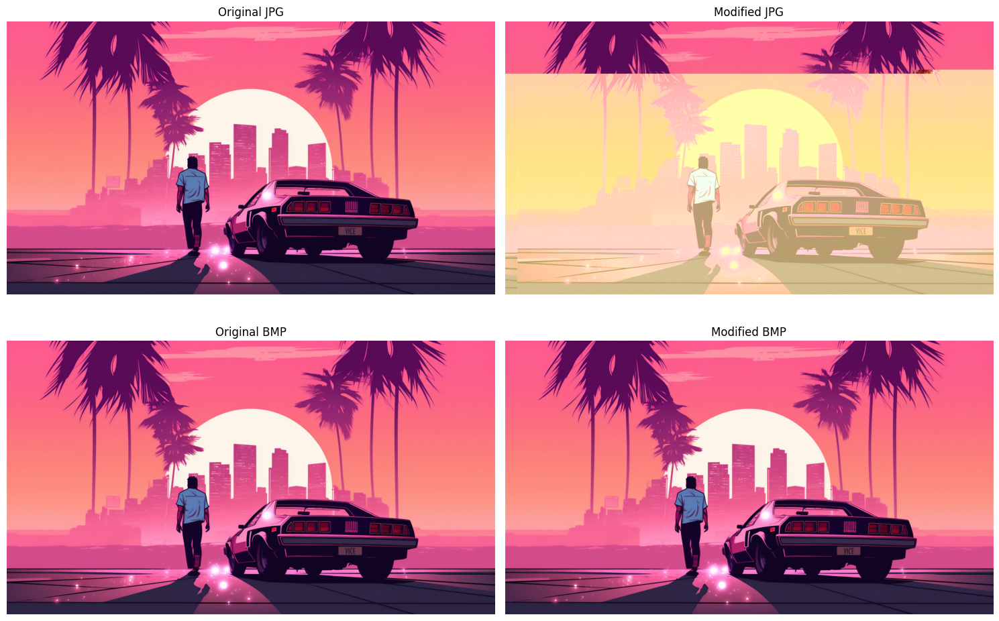


Iteration 9:
Random percentage: 36%
JPG: Flipped bit 0 in byte 76779
BMP: Flipped bit 2 in byte 2231243
JPG differences: [(76779, 0)]
BMP differences: [(2231243, 2)]


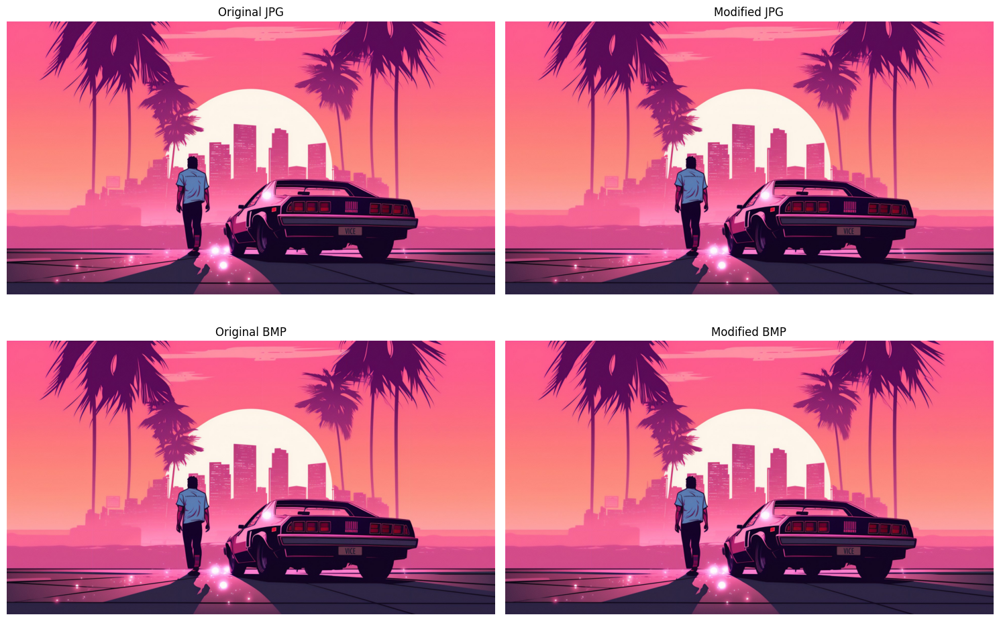


Iteration 10:
Random percentage: 87%
JPG: Flipped bit 2 in byte 185549
BMP: Flipped bit 2 in byte 5392171
JPG differences: [(185549, 2)]
BMP differences: [(5392171, 2)]


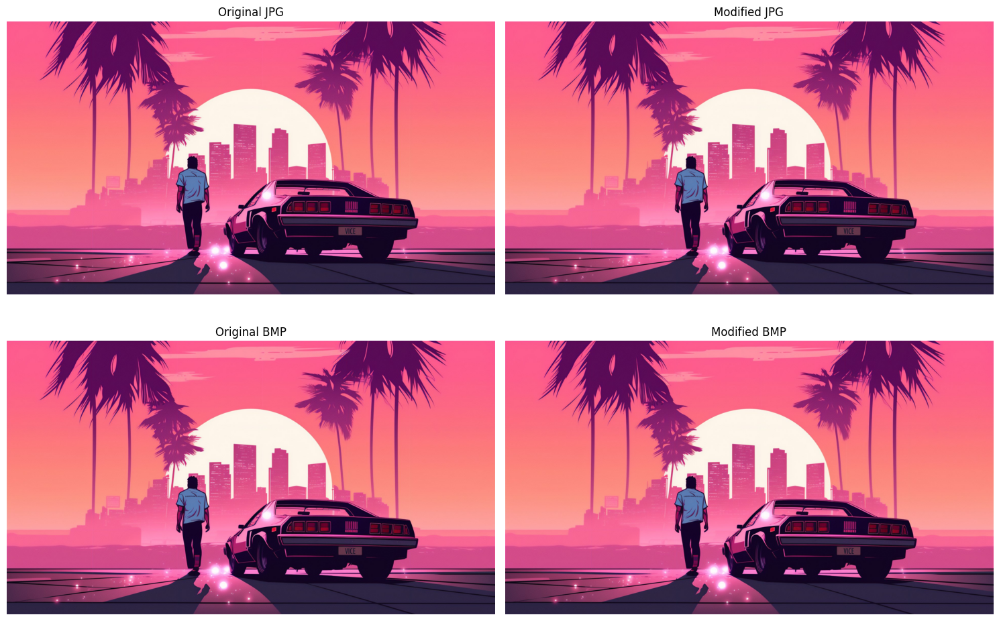


Iteration 11:
Random percentage: 70%
JPG: Flipped bit 4 in byte 149292
BMP: Flipped bit 4 in byte 4338528
JPG differences: [(149292, 4)]
BMP differences: [(4338528, 4)]


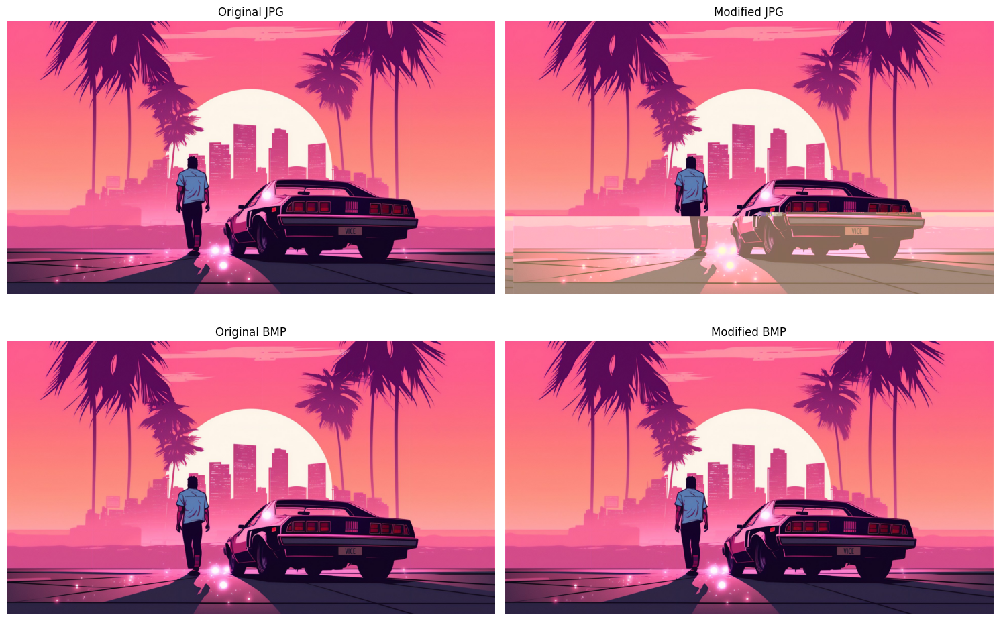


Iteration 12:
Random percentage: 88%
JPG: Flipped bit 0 in byte 187682
BMP: Flipped bit 1 in byte 5454150
JPG differences: [(187682, 0)]
BMP differences: [(5454150, 1)]


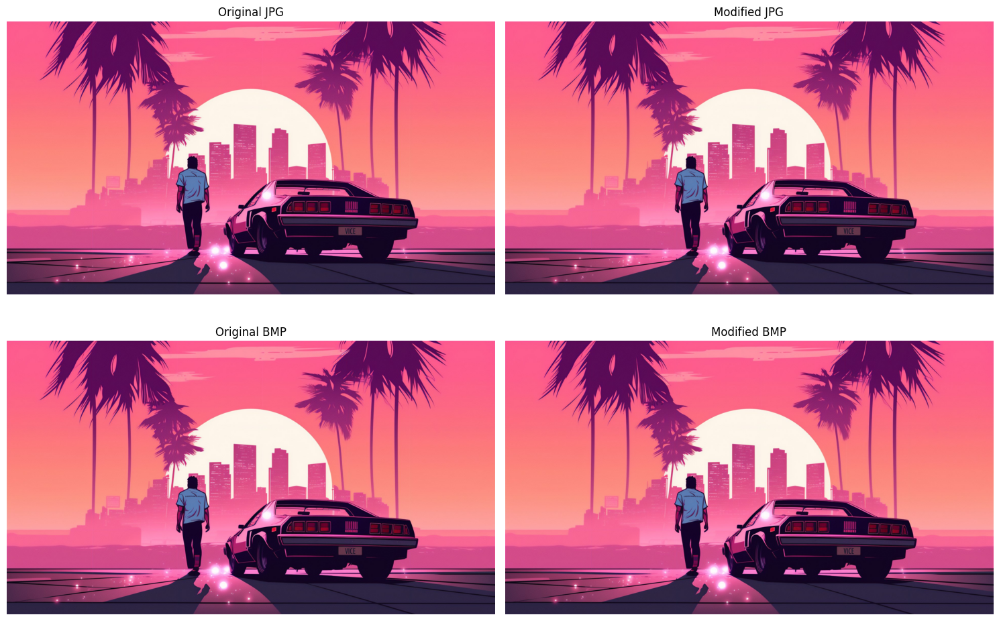


Iteration 13:
Random percentage: 88%
JPG: Flipped bit 0 in byte 187682
BMP: Flipped bit 1 in byte 5454150
JPG differences: [(187682, 0)]
BMP differences: [(5454150, 1)]


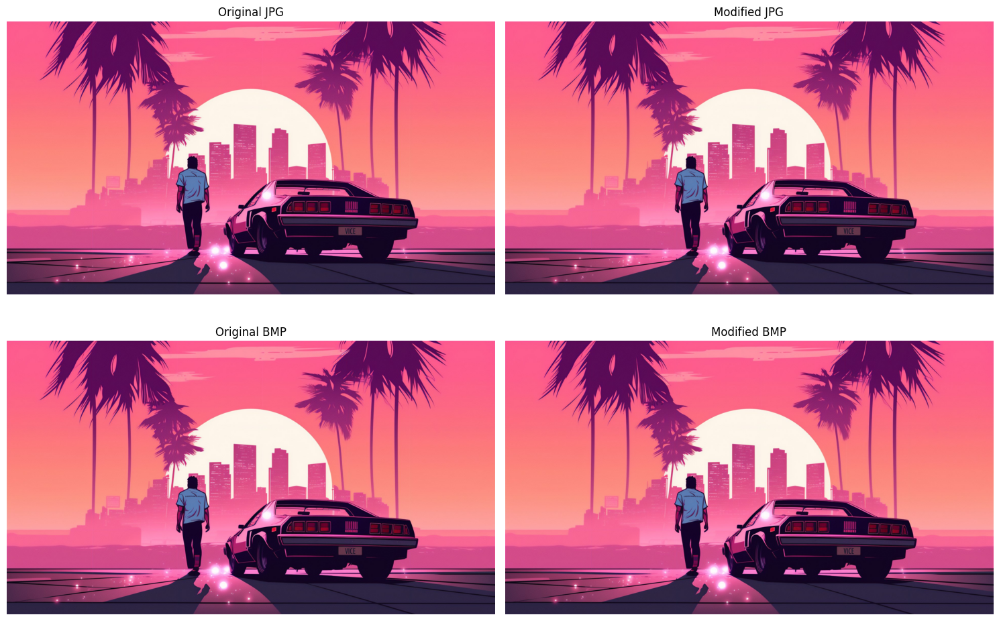


Iteration 14:
Random percentage: 12%
JPG: Flipped bit 0 in byte 25593
BMP: Flipped bit 6 in byte 743747
JPG differences: [(25593, 0)]
BMP differences: [(743747, 6)]


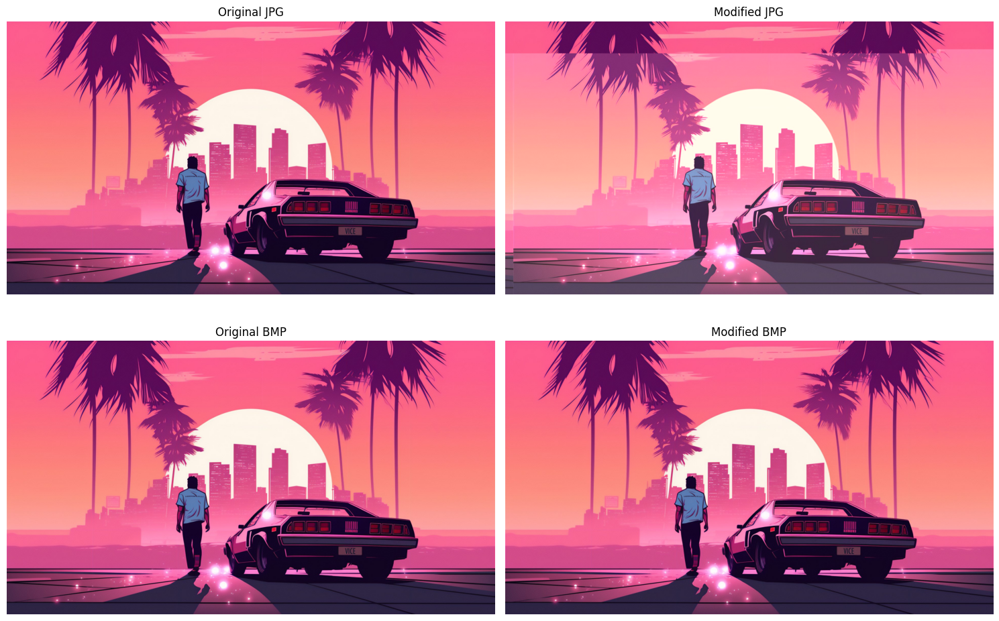


Iteration 15:
Random percentage: 58%
JPG: Flipped bit 3 in byte 123699
BMP: Flipped bit 6 in byte 3594780
JPG differences: [(123699, 3)]
BMP differences: [(3594780, 6)]


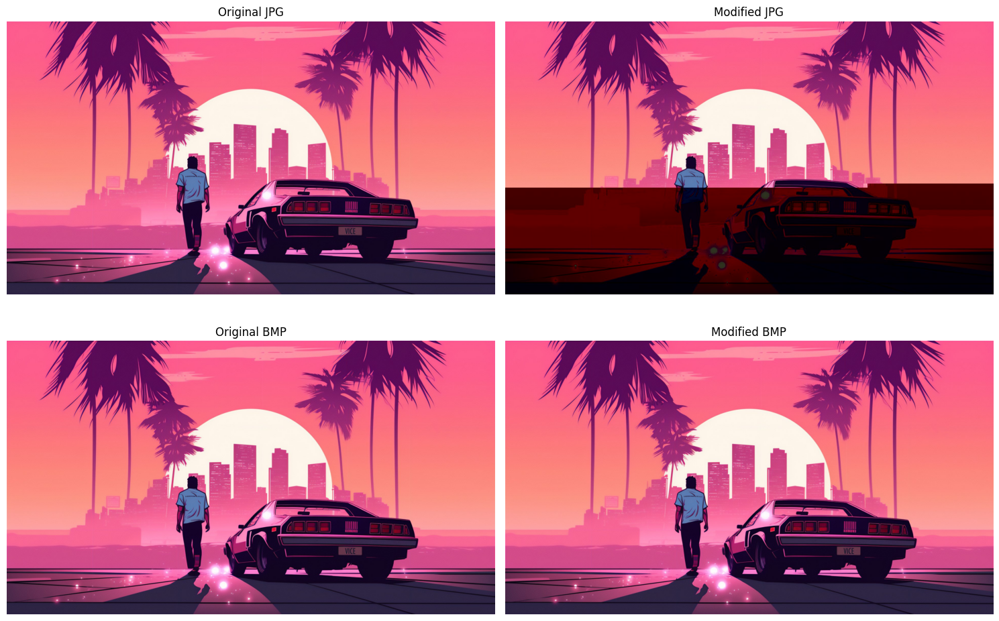


Iteration 16:
Random percentage: 65%
JPG: Flipped bit 6 in byte 138628
BMP: Flipped bit 5 in byte 4028633
JPG differences: [(138628, 6)]
BMP differences: [(4028633, 5)]


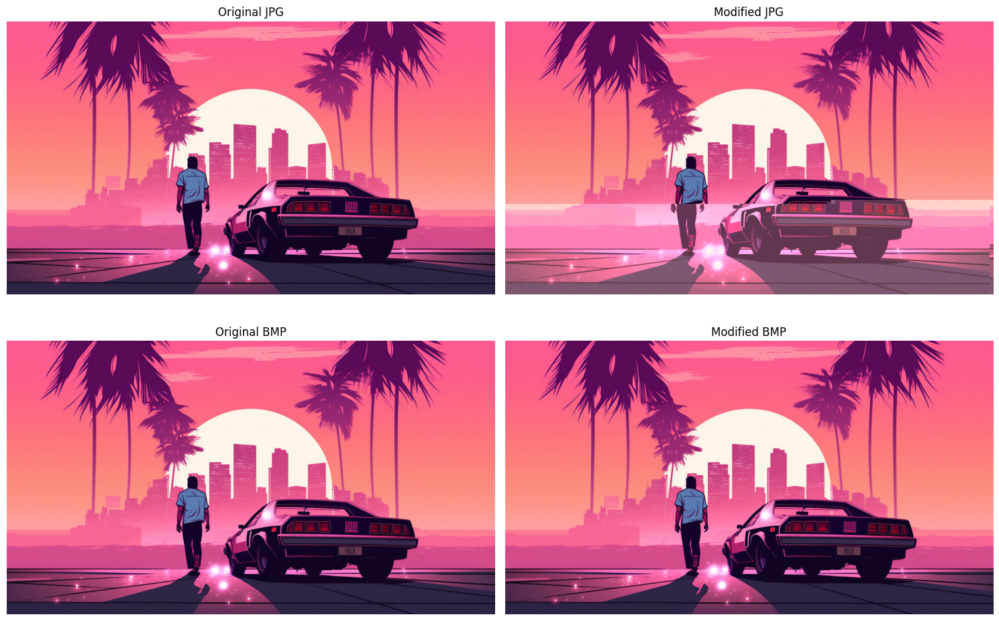


Iteration 17:
Random percentage: 39%
JPG: Flipped bit 2 in byte 83177
BMP: Flipped bit 1 in byte 2417180
JPG differences: [(83177, 2)]
BMP differences: [(2417180, 1)]


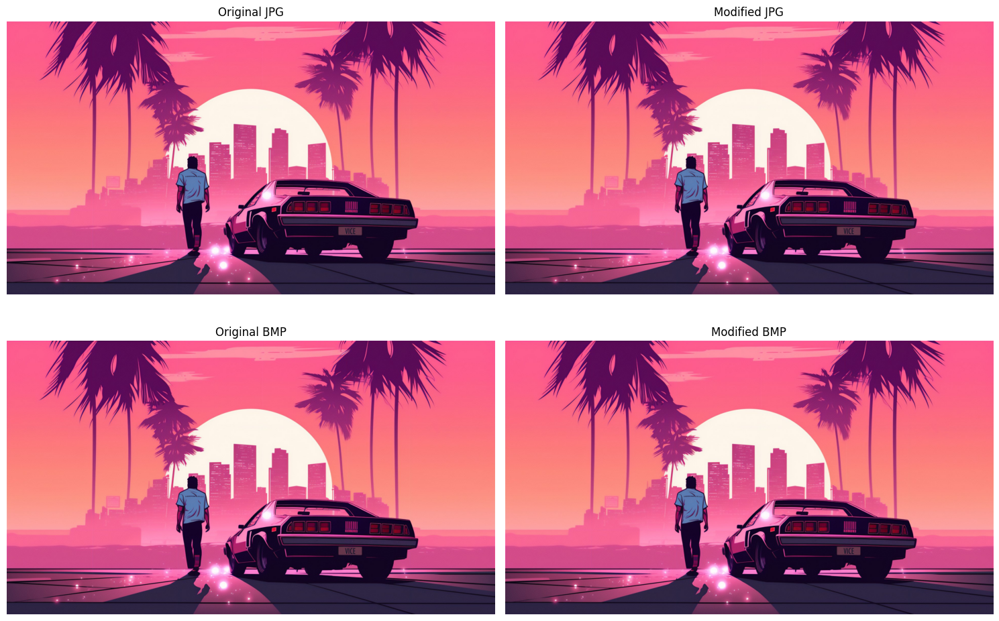


Iteration 18:
Random percentage: 87%
JPG: Flipped bit 2 in byte 185549
BMP: Flipped bit 2 in byte 5392171
JPG differences: [(185549, 2)]
BMP differences: [(5392171, 2)]


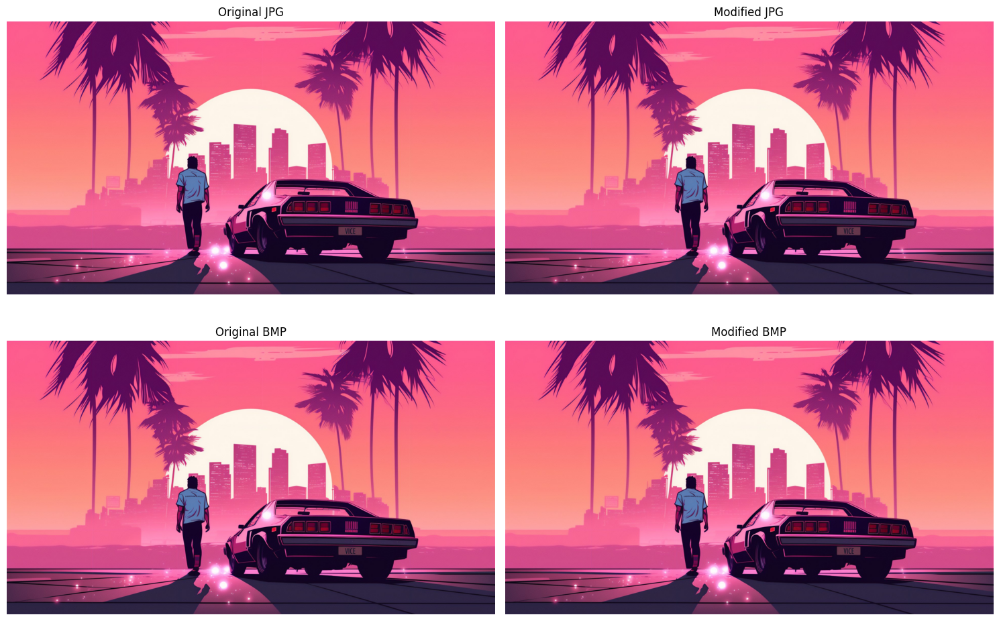


Iteration 19:
Random percentage: 46%
JPG: Flipped bit 4 in byte 98106
BMP: Flipped bit 0 in byte 2851033
JPG differences: [(98106, 4)]
BMP differences: [(2851033, 0)]


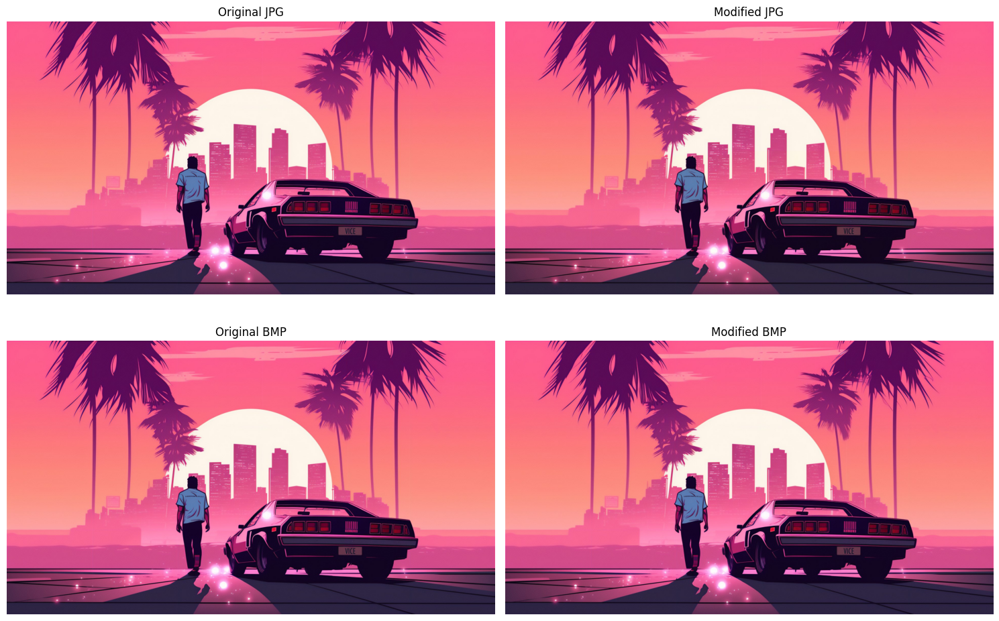


Iteration 20:
Random percentage: 88%
JPG: Flipped bit 0 in byte 187682
BMP: Flipped bit 1 in byte 5454150
JPG differences: [(187682, 0)]
BMP differences: [(5454150, 1)]


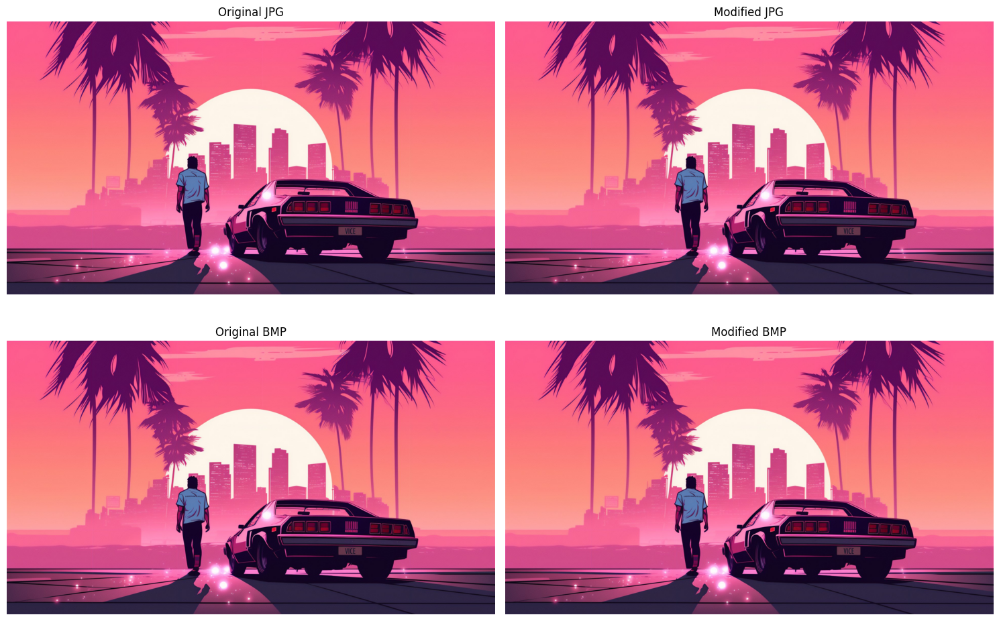


Iteration 21:
Random percentage: 81%
JPG: Flipped bit 6 in byte 172752
BMP: Flipped bit 3 in byte 5020297
JPG differences: [(172752, 6)]
BMP differences: [(5020297, 3)]


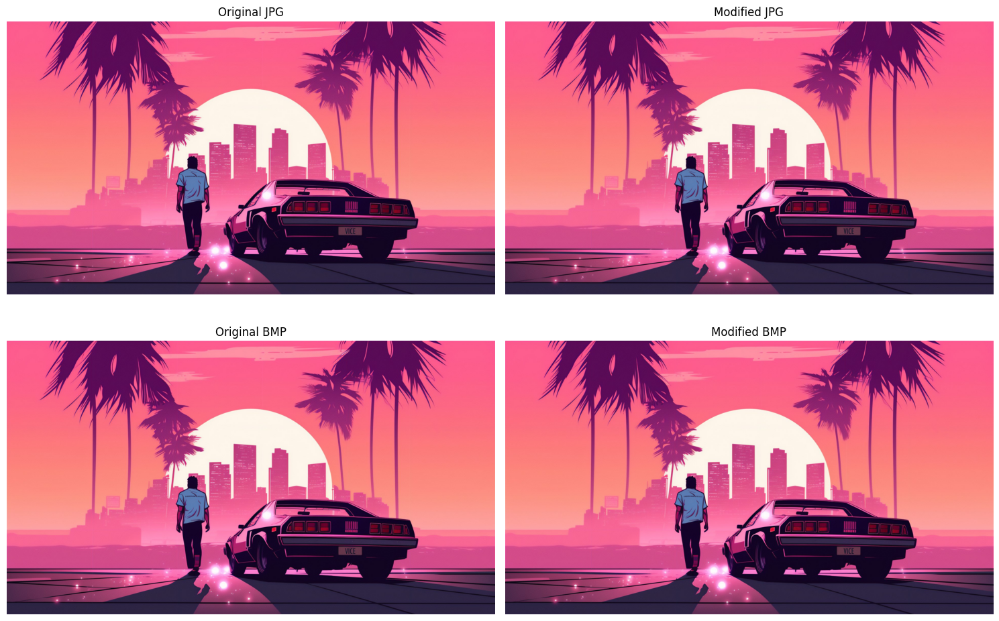


Iteration 22:
Random percentage: 37%
JPG: Flipped bit 6 in byte 78911
BMP: Flipped bit 2 in byte 2293222
JPG differences: [(78911, 6)]
BMP differences: [(2293222, 2)]


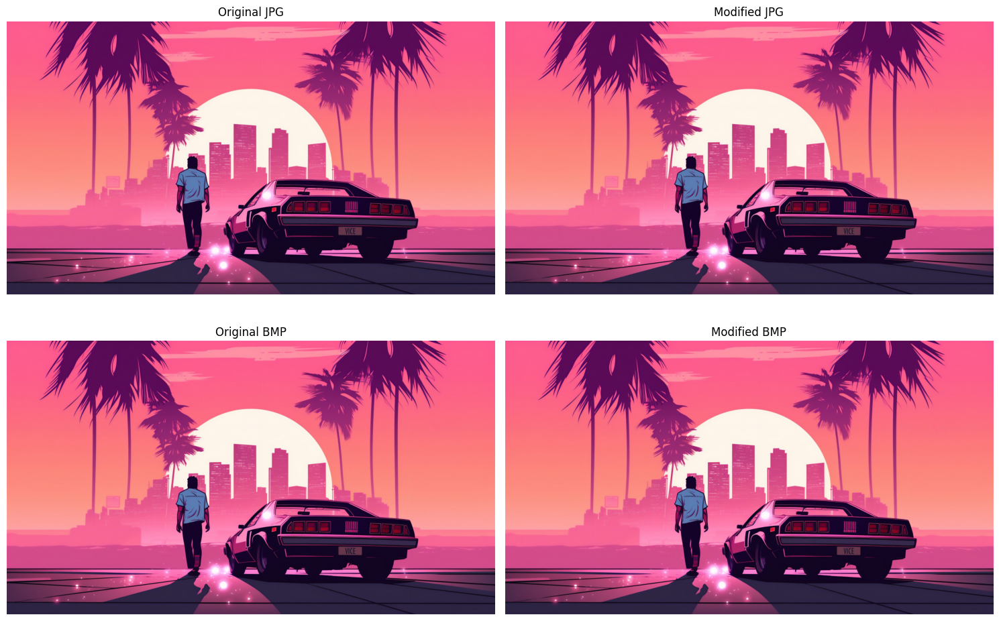


Iteration 23:
Random percentage: 25%
JPG: Flipped bit 6 in byte 53318
BMP: Flipped bit 4 in byte 1549474
JPG differences: [(53318, 6)]
BMP differences: [(1549474, 4)]


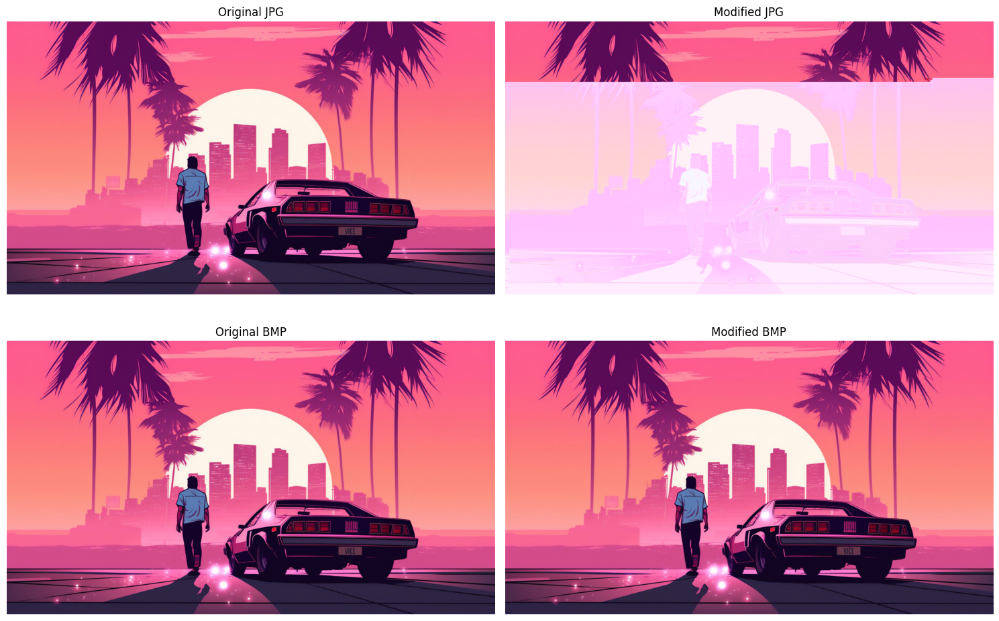


Iteration 24:
Random percentage: 77%
JPG: Flipped bit 6 in byte 164221
BMP: Flipped bit 3 in byte 4772381
JPG differences: [(164221, 6)]
BMP differences: [(4772381, 3)]


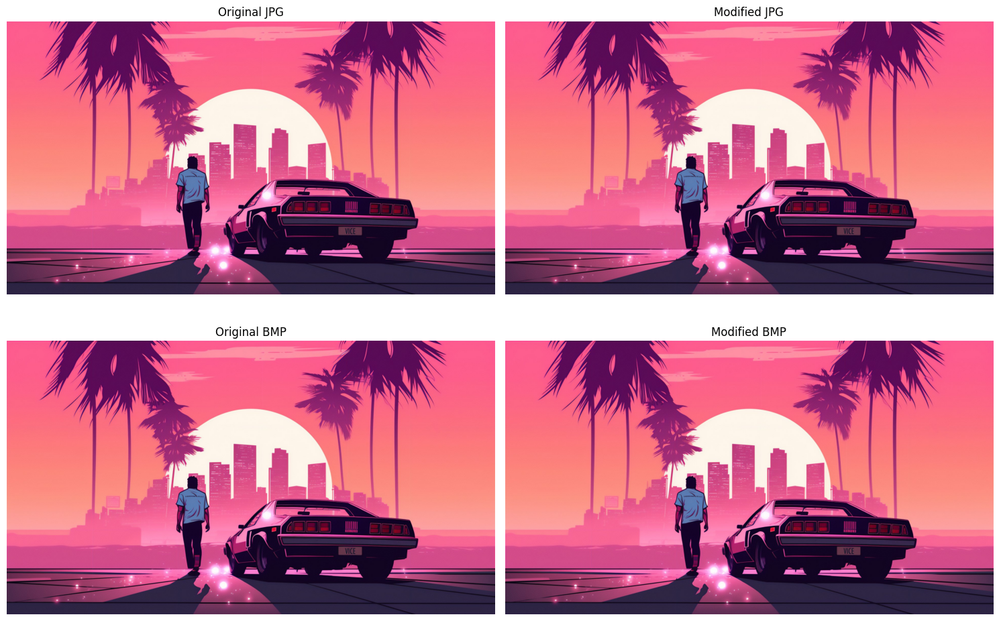


Iteration 25:
Random percentage: 72%
JPG: Flipped bit 0 in byte 153558
BMP: Flipped bit 4 in byte 4462486
JPG differences: [(153558, 0)]
BMP differences: [(4462486, 4)]


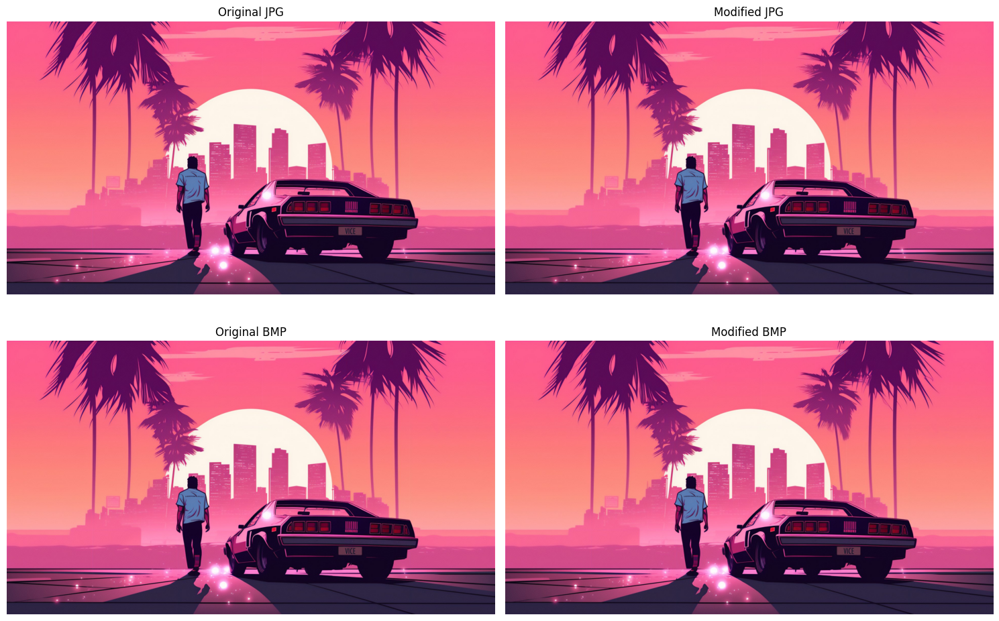


Iteration 26:
Random percentage: 9%
JPG: Flipped bit 6 in byte 19194
BMP: Flipped bit 6 in byte 557810
JPG differences: [(19194, 6)]
BMP differences: [(557810, 6)]


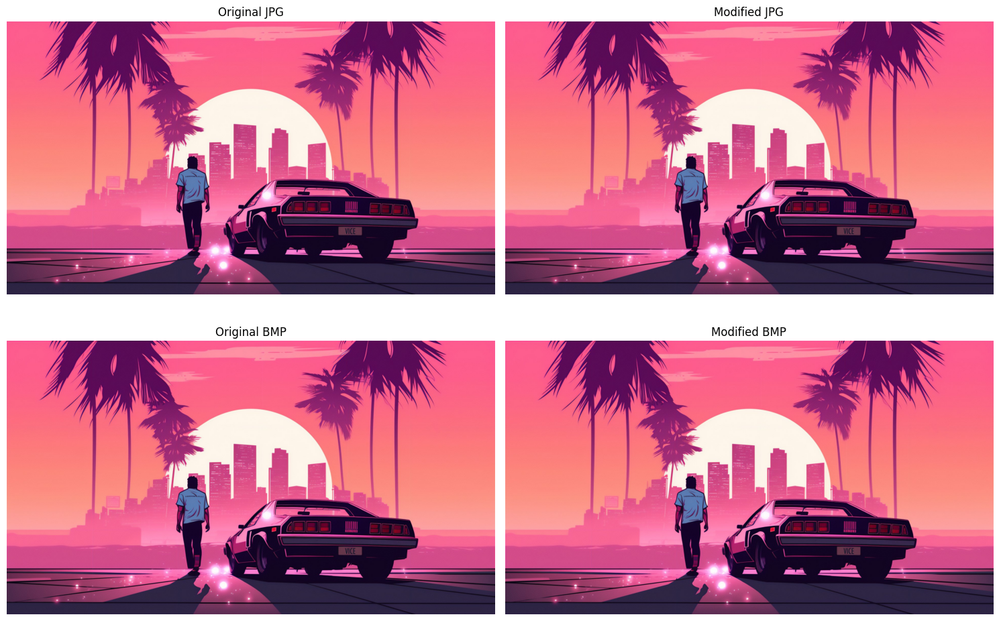


Iteration 27:
Random percentage: 20%
JPG: Flipped bit 0 in byte 42655
BMP: Flipped bit 4 in byte 1239579
JPG differences: [(42655, 0)]
BMP differences: [(1239579, 4)]


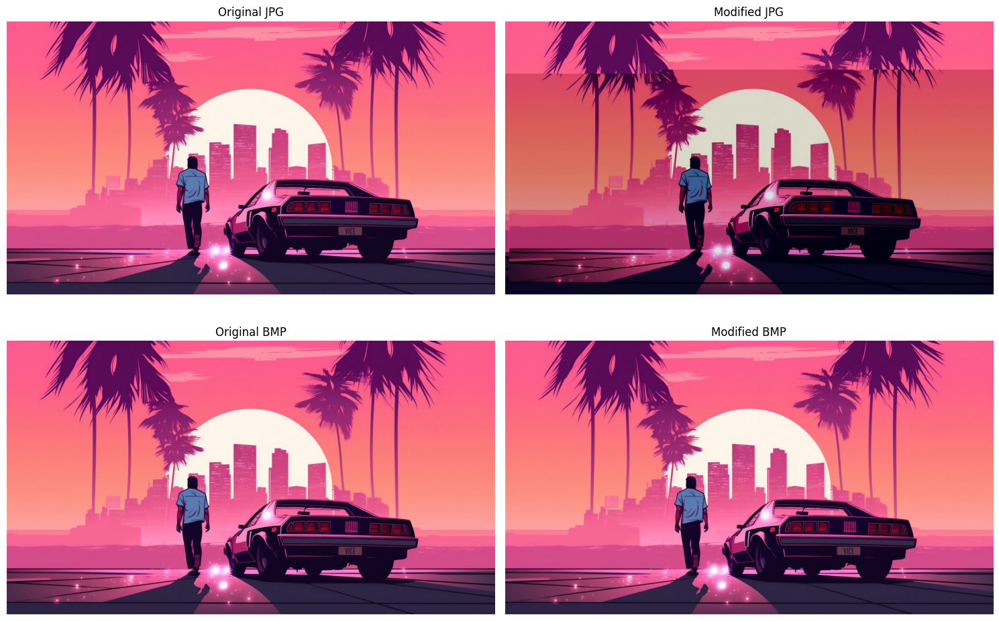


Iteration 28:
Random percentage: 80%
JPG: Flipped bit 0 in byte 170620
BMP: Flipped bit 3 in byte 4958318
JPG differences: [(170620, 0)]
BMP differences: [(4958318, 3)]


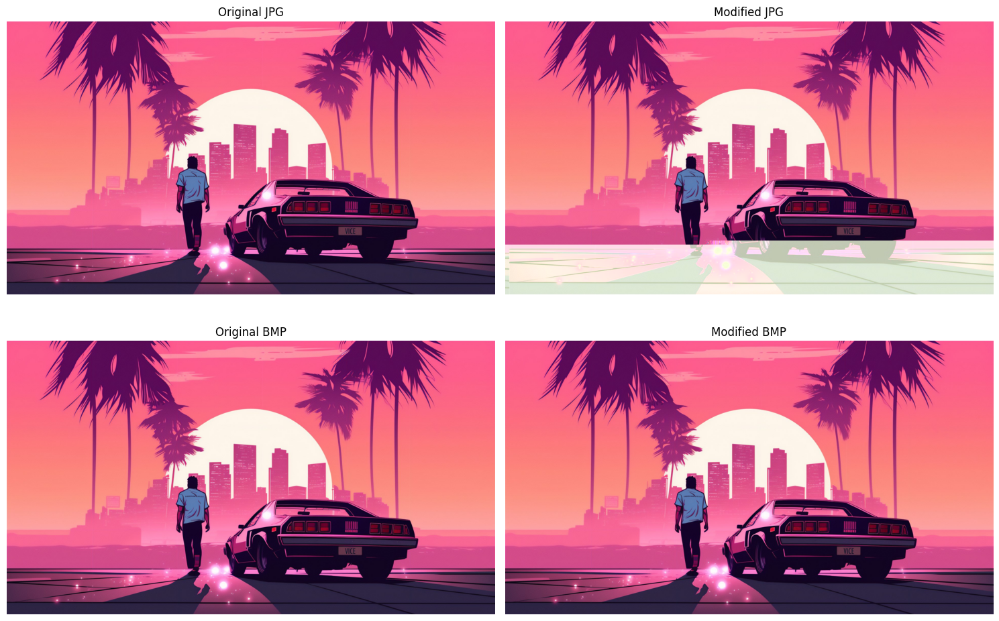


Iteration 29:
Random percentage: 69%
JPG: Flipped bit 6 in byte 147159
BMP: Flipped bit 4 in byte 4276549
JPG differences: [(147159, 6)]
BMP differences: [(4276549, 4)]


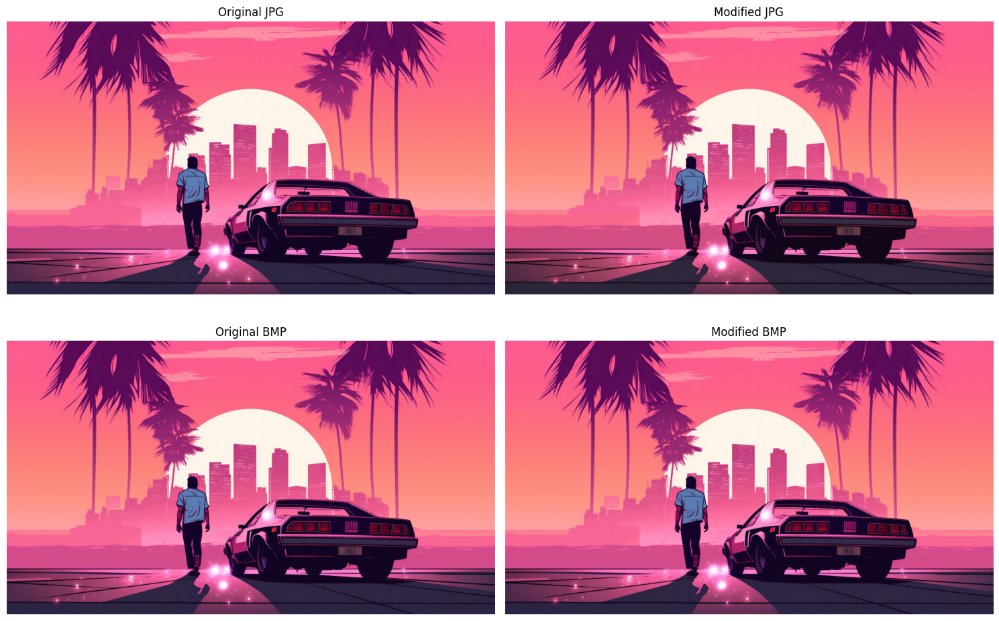


Iteration 30:
Random percentage: 79%
JPG: Flipped bit 2 in byte 168487
BMP: Flipped bit 3 in byte 4896339
JPG differences: [(168487, 2)]
BMP differences: [(4896339, 3)]


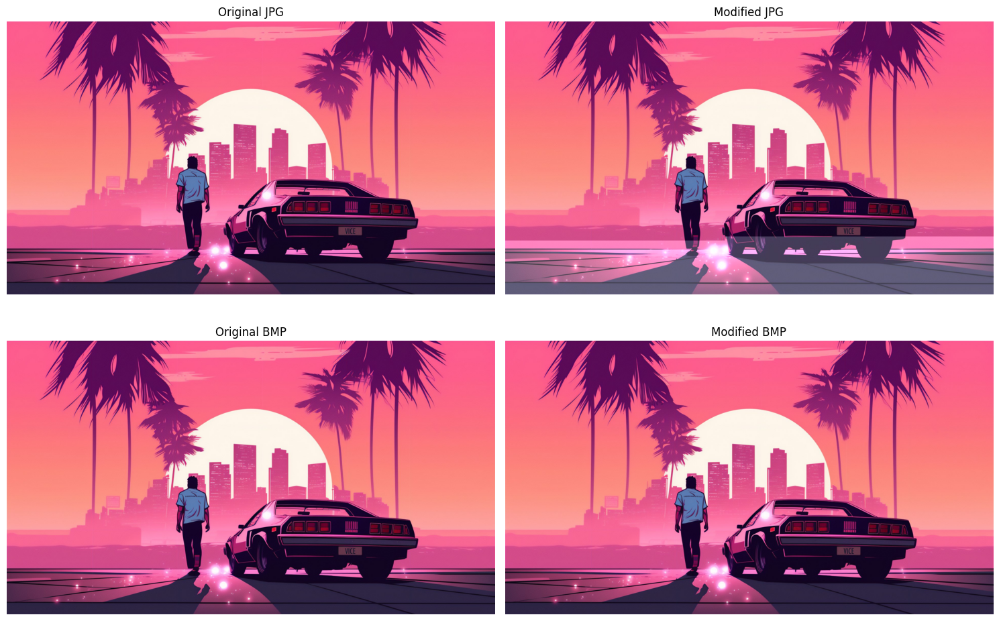

In [15]:
for i, percentage in enumerate(random_percentages):

    modified_jpg = f'modified_picture_jpg_{i}.jpg'
    jpg_byte, jpg_bit = flip_random_bit(original_jpg, modified_jpg, percentage)
    
    modified_bmp = f'modified_picture_bmp_{i}.bmp'
    bmp_byte, bmp_bit = flip_random_bit(original_bmp, modified_bmp, percentage)
    
    jpg_diff = compare_files(original_jpg, modified_jpg)
    bmp_diff = compare_files(original_bmp, modified_bmp)
    
    print(f"\nIteration {i+1}:")
    print(f"Random percentage: {percentage}%")
    print(f"JPG: Flipped bit {jpg_bit} in byte {jpg_byte}")
    print(f"BMP: Flipped bit {bmp_bit} in byte {bmp_byte}")
    print(f"JPG differences: {jpg_diff}")
    print(f"BMP differences: {bmp_diff}")

    fig, axs = plt.subplots(2, 2, figsize=(15, 10))
    
    images = [
        (axs[0, 0], original_jpg, 'Original JPG'),
        (axs[0, 1], modified_jpg, 'Modified JPG'),
        (axs[1, 0], original_bmp, 'Original BMP'),
        (axs[1, 1], modified_bmp, 'Modified BMP')
    ]

    for ax, img_path, title in images:
        try:
            ax.imshow(mpimg.imread(img_path))
            ax.axis('off')
            ax.set_title(title)
        except Exception as e:
            print(f"Error displaying {title}: {str(e)}")
            ax.text(0.5, 0.5, f"Error: Unable to display {title}", 
                    ha='center', va='center', transform=ax.transAxes)
            ax.axis('off')
    
    plt.tight_layout()
    plt.show()

<span style="color: green;">

some of JPEG images were altered by changing a single bit in each, with one of them becoming completely unviewable. However, none of the bitmap images were corrupted. It should be noted that if the initial bits (the header bits of the files) had been altered, the bitmaps could also have become corrupted and might not open at all. The reason is that changing the bits in the middle of a bitmap file does not lead to corruption, due to the redundancy present, which is why bitmap files tend to be larger than JPEG files.

</span>

<span style="color: red;">

If you want to do this manually, you can also use the `hexedit` or `010editor` application.

</span>


```
hexedit looks like the image below, where I opened the file picture.jpg. Just go to the desired byte, change it, then press Ctrl + S to save and exit the edit page.
```

![hexedit image](./hexedit_image.png)

<span style="color: green; font-size: 35px;">

Explanation of the tasks I performed:

</span>

First of all, I downloaded a JPG file from the internet using the `wget` command. Then, I used the `convert` command to convert it to a Bitmap file. Now I have both a JPG and a Bitmap version of the image.

After that, I displayed the images using the Matplotlib library. I then located the middle bit of the file and changed it, saving the new information in new files. I displayed these as well, which caused the JPG image to become corrupted, whereas the Bitmap remained unchanged.

Next, I defined a random seed to generate the same pseudo-random numbers each time the program ran. I flipped bits 30 times by producing random numbers between 0 and 100, and based on the percentage, I flipped the bit that was located at that percentage in the file. I showed the results (images with flipped bits), and none of the Bitmap images were affected, but the JPG images occasionally became corrupted or, in some cases, wouldn't open at all. It’s worth noting that changing the initial bits of the file, whether in Bitmap or JPG formats, can disrupt the file due to the presence of the header, potentially leading to an inability to open the image.

The same tasks could also be accomplished using hexedit or any zero-one editor, but I did not perform that as it yielded no new results and was therefore excluded from my report.

Based on the experiment conducted, the JPG format is highly sensitive to changes due to its use of compression for low storage capacity, as we observed this sensitivity. However, the Bitmap format stores image data pixel by pixel, so any changes would only affect a single pixel at most, which often remains unchanged.
